算法思想：根据某个已经训练好的特征抽取网络，为使某种损失最小化进行BP计算，改变输入参数。

在CNN中，网络中每一层输出的不同Tensor关注的原图中的信息是不一样的，对某种信息的相应输出是更大一些的。那么是否可以通过针对某种特别的tensor，以增大其对某种目标的响应值进行训练，从而改变原图中对应信息的显著程度呢？

Deep Dream就是这一思想的一种实现。

In [1]:
import tensorflow as tf
import numpy as np
import cv2
from imageio import imread, imsave, mimsave
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.ndimage.filters import gaussian_filter  # 平滑处理

#### 使用预训练inception model

In [2]:
# 提取tensor
layer_names = [
    'conv2d0', 'conv2d1', 'conv2d2', 'mixed3a', 'mixed3b', 'mixed4a',
    'mixed4b', 'mixed4c', 'mixed4d', 'mixed4e', 'mixed5a', 'mixed5b'
]

graph = tf.Graph()
with graph.as_default():
    with tf.gfile.FastGFile('inception5h.pb', 'rb') as f:
        graph_def = tf.GraphDef()
        graph_def.ParseFromString(f.read())
        tf.import_graph_def(graph_def, name='')
    
    # 算法关注层
    X = graph.get_tensor_by_name('input:0')
    layers = [graph.get_tensor_by_name(name + ':0') for name in layer_names]
    
    # 网络所有层
    all_layers_names = [
        tensor.name for tensor in tf.get_default_graph().as_graph_def().node
    ]
    
    # print(all_layers_names)

In [3]:
sess = tf.Session(graph=graph)

#### 梯度计算

In [4]:
def get_gradient(tensor):
    """获取目标tensor，对于input的梯度，即，调整方向"""
    with graph.as_default():
        return tf.gradients(tf.reduce_mean(tf.square(tensor)), X)[0]


def get_tile_size(num_pixels, tile_size=400):
    """输入图片分区处理，每一个小部分分别进行求导。主要因为输入大小不确定。"""
    num_tiles = max(1, int(round(num_pixels / tile_size)))
    return int(np.ceil(num_pixels / num_tiles))


def tiled_gradient(gradient, image, tile_size=400):
    """图片分区求梯度"""
    grad = np.zeros_like(image)
    H, W, _ = image.shape

    h = get_tile_size(H, tile_size)
    w = get_tile_size(W, tile_size)

    # 随机切分参数，可以自行修改
    h_4 = h // 4
    w_4 = w // 4

    # 图片随机分区处理
    h_start = np.random.randint(-3 * h_4, -h_4)
    while h_start < H:
        # 分区终点
        h_end = h_start + h
        # 在随机的基础上，分区图片的pixel坐标，仍在图片只内
        h_start_lim = max(h_start, 0)
        h_end_lim = min(h_end, H)

        # 宽度方向上，相同处理方式
        w_start = np.random.randint(-3 * w_4, -w_4)
        while w_start < W:
            w_end = w_start + w

            w_start_lim = max(w_start, 0)
            w_end_lim = min(w_end, W)

            # 对子图求梯度，tensor在调用get_gradient()函数时给出
            g = sess.run(
                gradient,
                feed_dict={
                    X:
                    [image[h_start_lim:h_end_lim, w_start_lim:w_end_lim, :]]
                })[0]
            # 防止梯度过小
            g /= (np.std(g) + 1e-8)

            # 储存
            grad[h_start_lim:h_end_lim, w_start_lim:w_end_lim, :] = g

            w_start = w_end

        h_start = h_end

    return grad

#### 模型训练

In [5]:
def dream(layer_tensor, image, iteration=10, step=3.0, tile_size=400):
    """在目标tensor对X的梯度方向上，手动更新X，梯队上升的方法使tf.reduce_mean(tf.square(tensor))
    增大"""
    img = image.copy()
    gradient = get_gradient(layer_tensor)

    for i in range(iteration):
        # 计算梯度
        grad = tiled_gradient(gradient, img)

        # 梯度平滑处理
        sigma = (i * 4.0) / iteration + 0.5
        grad = gaussian_filter(grad, 0.5 * sigma) + gaussian_filter(
            grad, sigma) + gaussian_filter(grad, 2 * sigma)

        # X更新步长
        scaled_step = step / (np.std(grad) + 1e-8)
        # 根据梯度，更新X
        img += grad * scaled_step
        img = np.clip(img, 0, 255)

    return img


def recursive_dream(layer_tensor,
                    image,
                    repeat=3,
                    scale=0.7,
                    blend=0.2,
                    iteration=10,
                    step=3.0,
                    tile_size=400):
    """多尺度层次上进行X更新并叠加
    
    params：layer_tensor--关注的tensor，多个feature map
                   repeat--多尺度计算轮次
                   scale--每次尺度缩放比例
                   blend--在原图image上叠加（1 - blend）的dream函数更新结果
                   step--更新步长
                   tile_size--子图大小
    """
    if repeat > 0:
        sigma = 0.5
        # 原图平滑处理
        img_blur = gaussian_filter(image, (sigma, sigma, 0.0))

        # 原图大小
        h0 = img_blur.shape[0]
        w0 = img_blur.shape[1]
        # 缩小大小
        h1 = int(scale * h0)
        w1 = int(scale * w0)
        img_downscaled = cv2.resize(img_blur, (w1, h1))

        # 递归实现多尺度
        img_dream = recursive_dream(layer_tensor, img_downscaled, repeat - 1,
                                    scale, blend, iteration, step, tile_size)
        img_upscaled = cv2.resize(img_dream, (w0, h0))

        # 叠加X更新结果
        image = blend * image + (1.0 - blend) * img_upscaled
        image = np.clip(image, 0, 255)

    return dream(layer_tensor, image, iteration, step, tile_size)

##### 不同层对X的影响

conv2d0


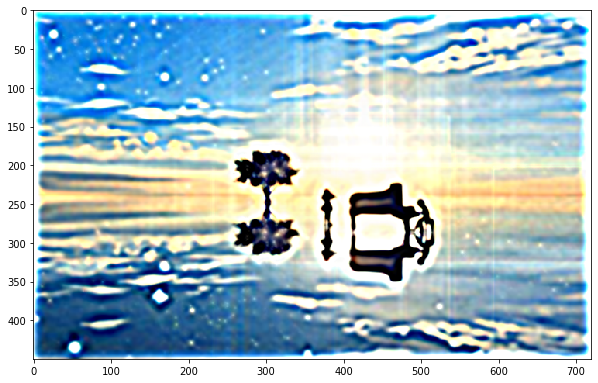

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


conv2d1


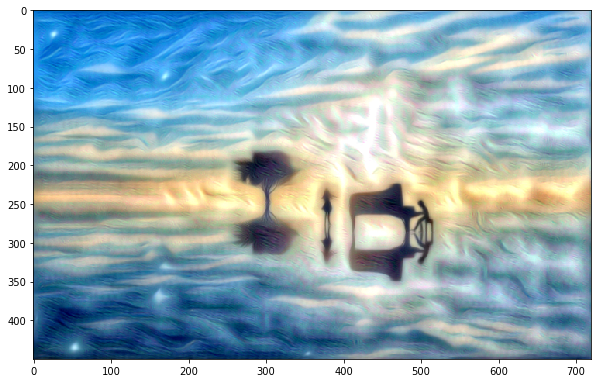

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


conv2d2


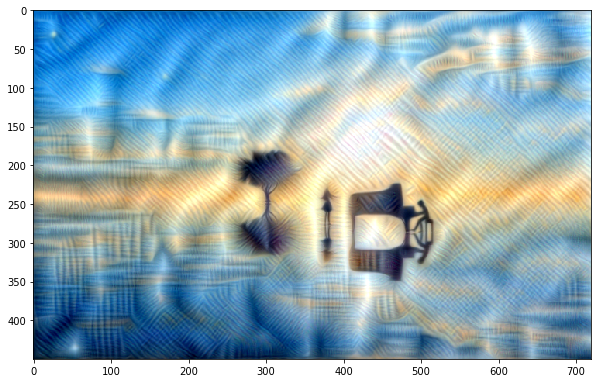

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed3a


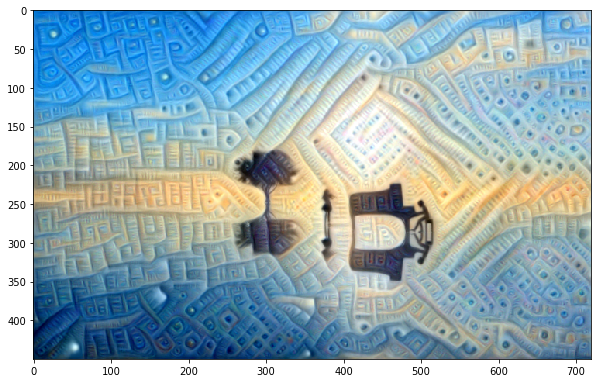

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed3b


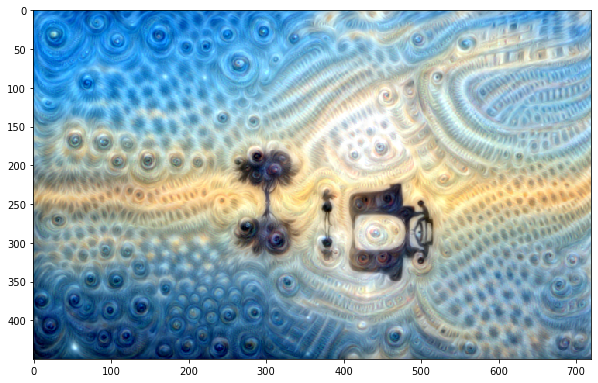

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed4a


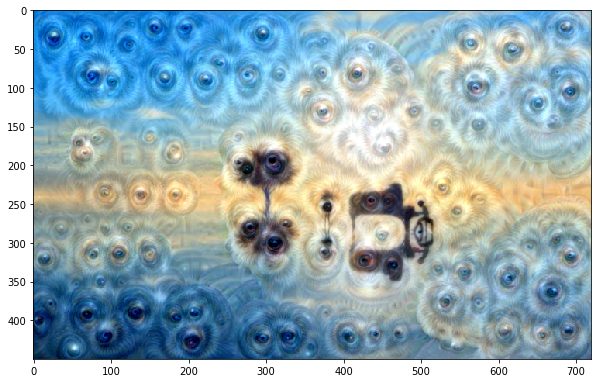

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed4b


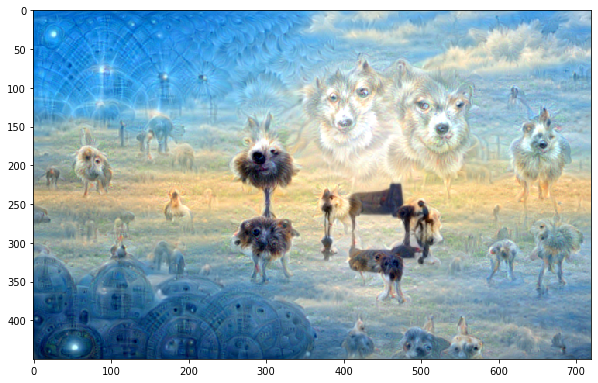

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed4c


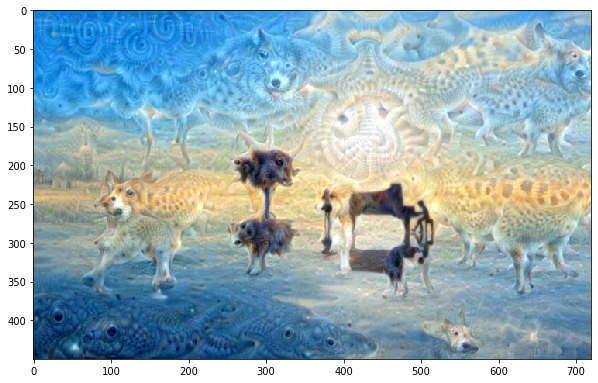

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed4d


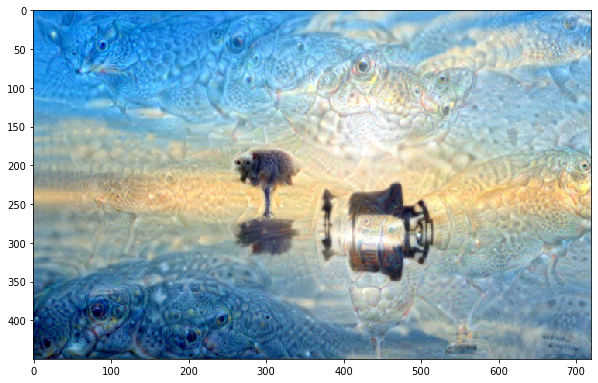

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed4e


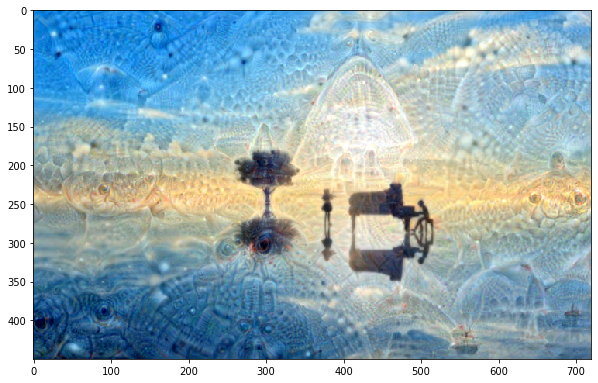

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed5a


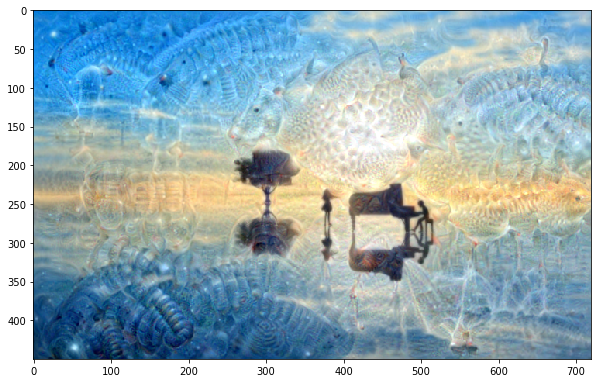

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


mixed5b


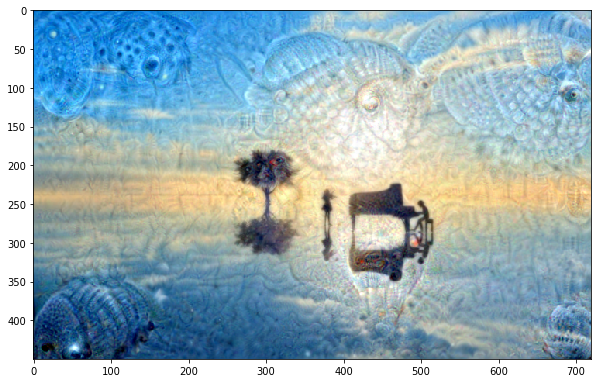

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


In [7]:
image = imread('test.jpg')
image = image.astype(np.float32)

for i in range(len(layers)):
    print(layer_names[i])
    
    result = recursive_dream(layers[i], image)
    
    plt.figure(figsize=(10, 15))
    plt.imshow(result / 255.)
    plt.show()
    
    imsave('imgs/%s.jpg' % layer_names[i], result)

##### 相同tensor，不同filter对X的影响

Filter 0 of mixed4b


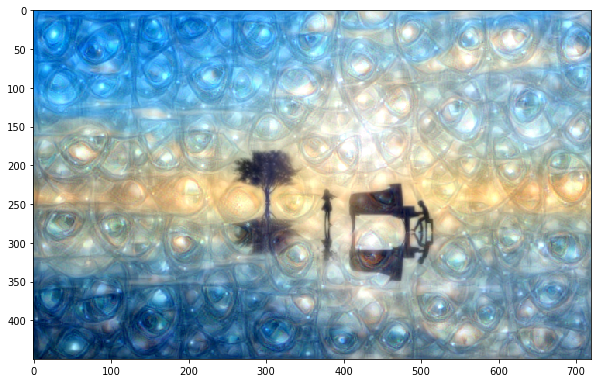

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 1 of mixed4b


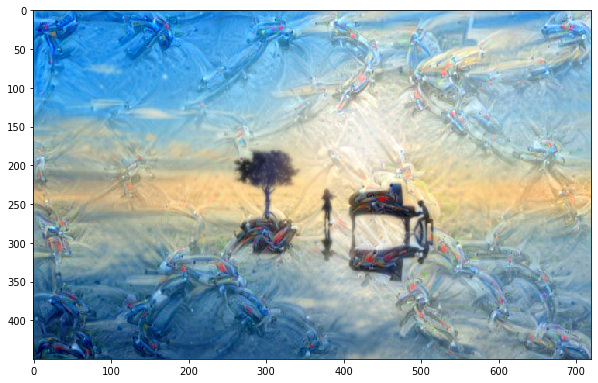

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 2 of mixed4b


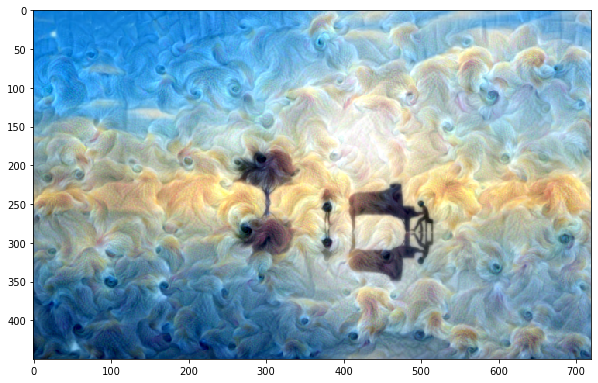

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 3 of mixed4b


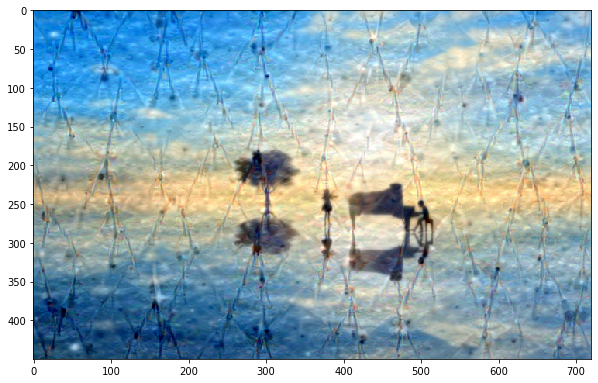

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 4 of mixed4b


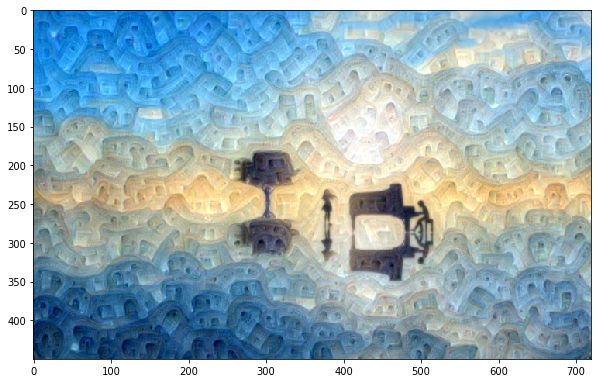

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 5 of mixed4b


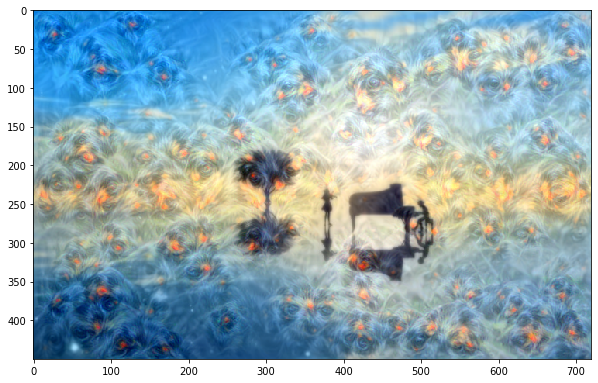

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 6 of mixed4b


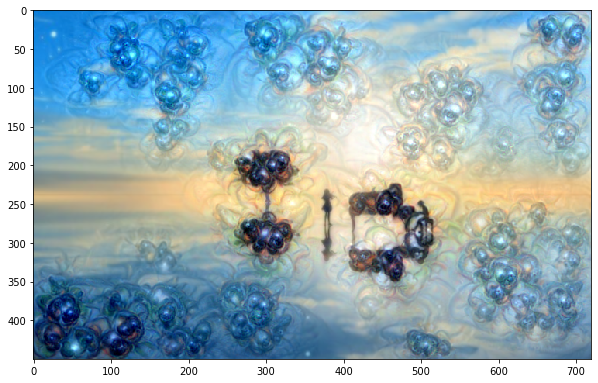

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 7 of mixed4b


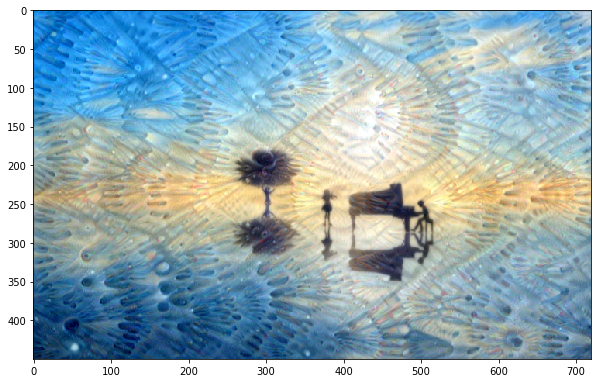

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 8 of mixed4b


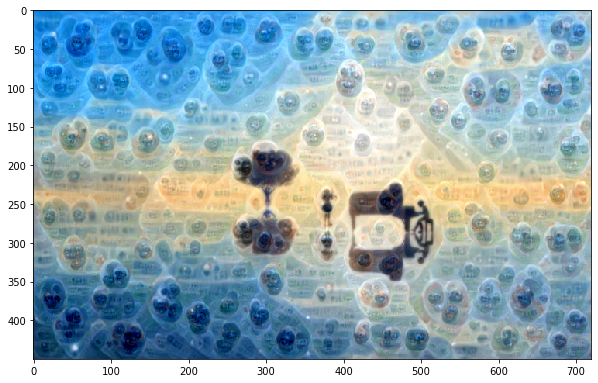

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


Filter 9 of mixed4b


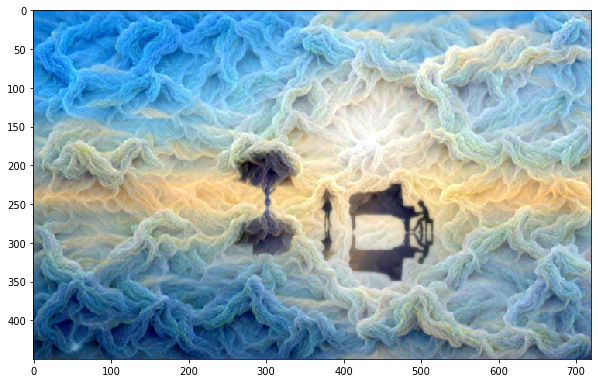

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


In [8]:
for i in range(10):
    print('Filter %d of mixed4b' % i)
    
    result = recursive_dream(layers[6][:, :, :, i], image)
    
    plt.figure(figsize=(10, 15))
    plt.imshow(result / 255.)
    plt.show()
    imsave('imgs/mixed4b_filter_%d.jpg' % i, result)

##### 增加迭代轮次生成GIF

Iteration 0 of mixed4b


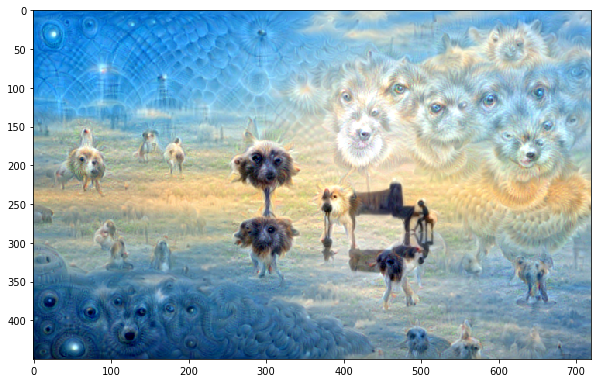

Iteration 1 of mixed4b


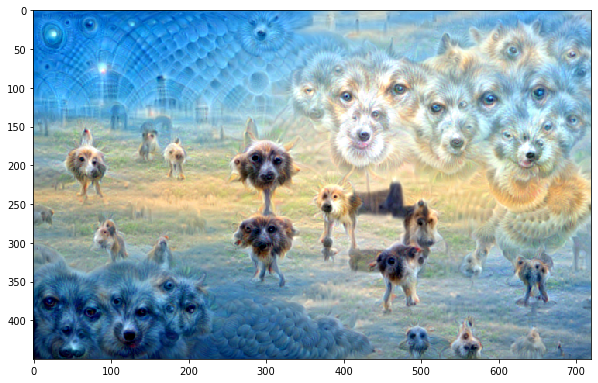

Iteration 2 of mixed4b


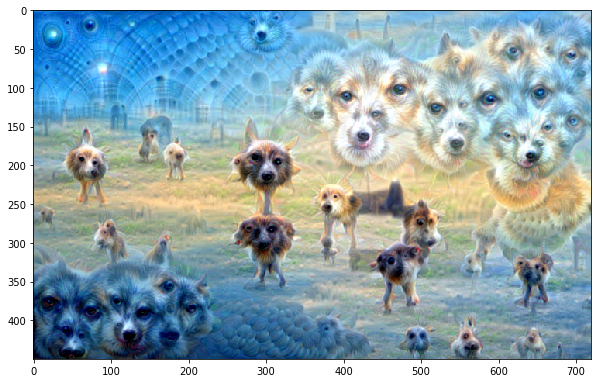

Iteration 3 of mixed4b


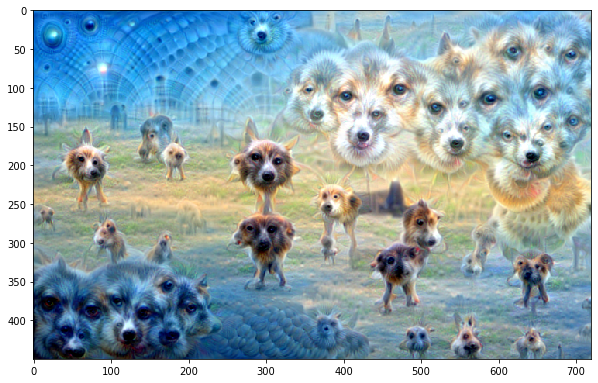

Iteration 4 of mixed4b


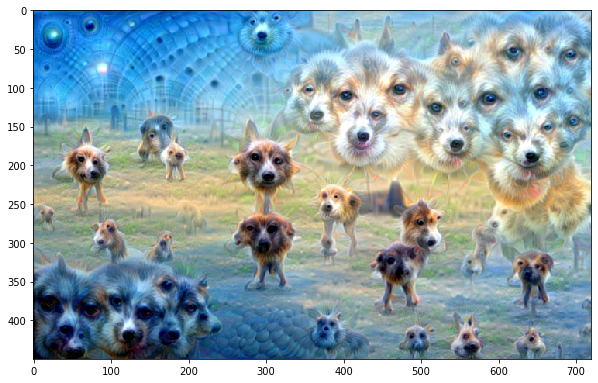

Iteration 5 of mixed4b


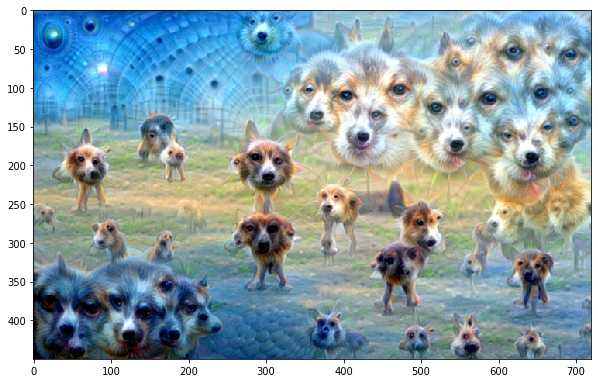

Iteration 6 of mixed4b


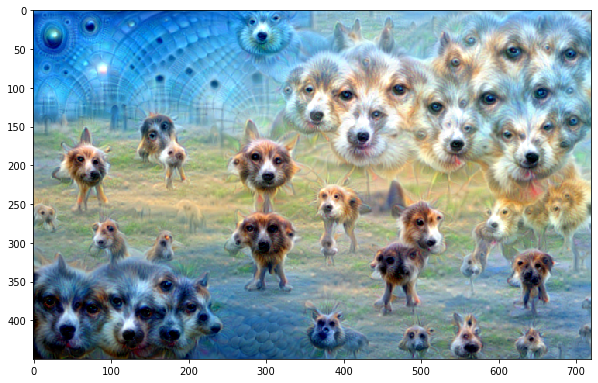

Iteration 7 of mixed4b


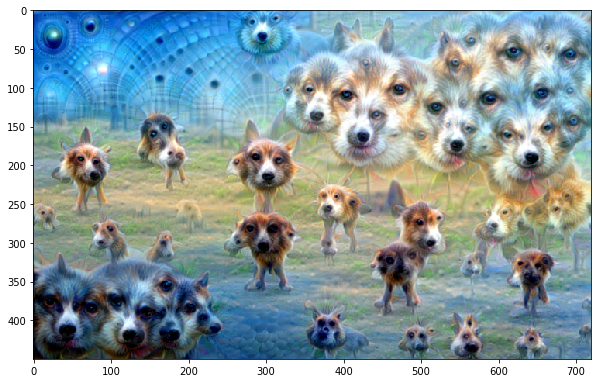

Iteration 8 of mixed4b


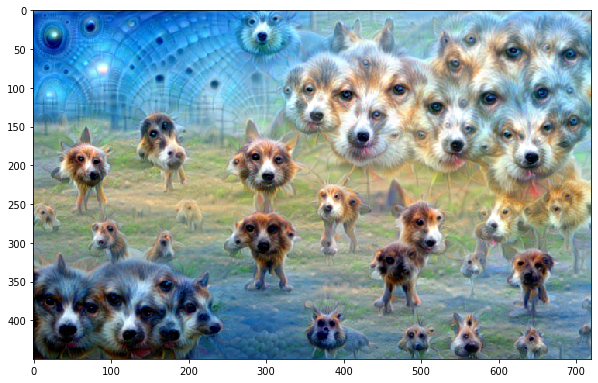

Iteration 9 of mixed4b


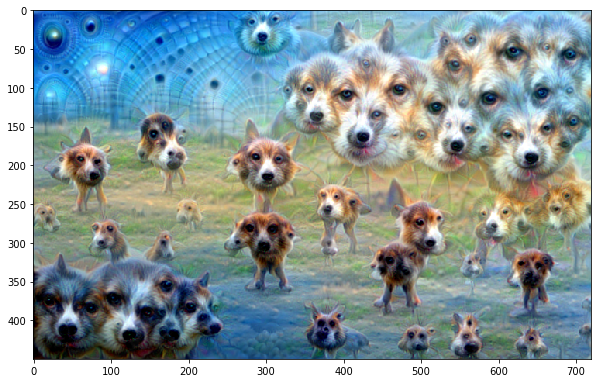

Iteration 10 of mixed4b


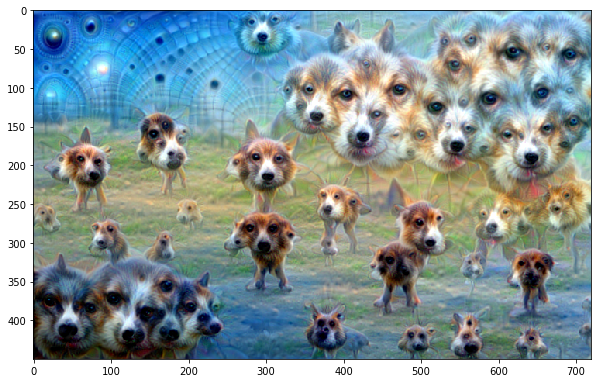

Iteration 11 of mixed4b


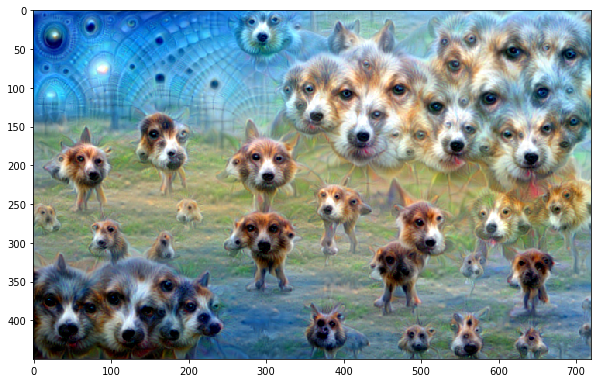

Iteration 12 of mixed4b


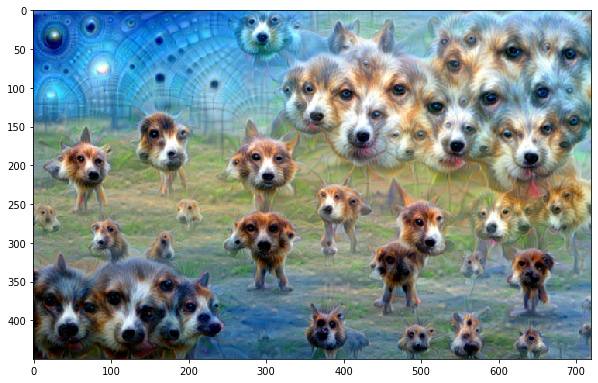

Iteration 13 of mixed4b


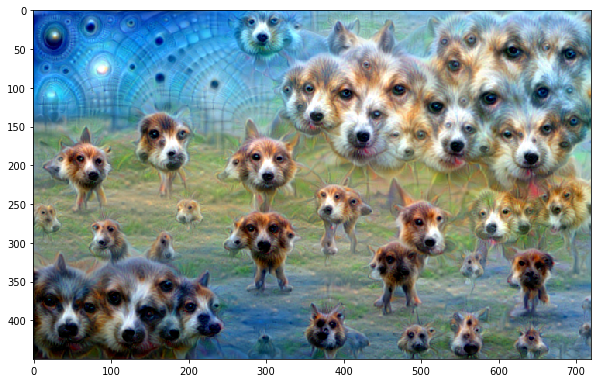

Iteration 14 of mixed4b


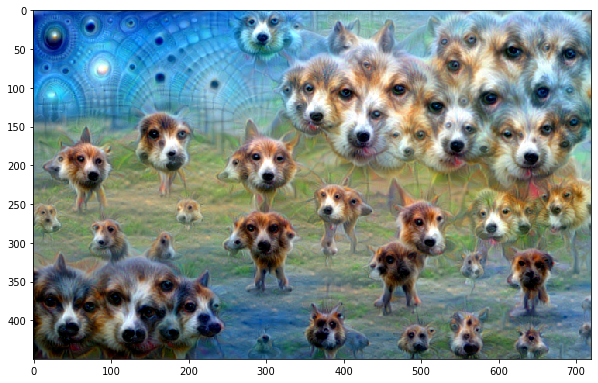

Iteration 15 of mixed4b


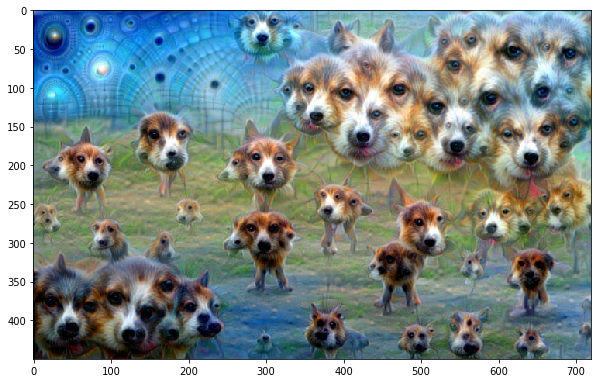

Iteration 16 of mixed4b


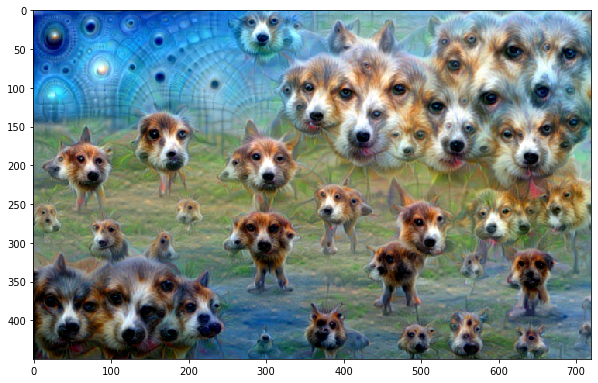

Iteration 17 of mixed4b


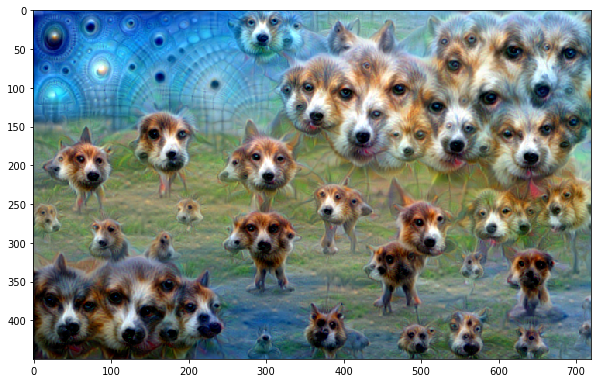

Iteration 18 of mixed4b


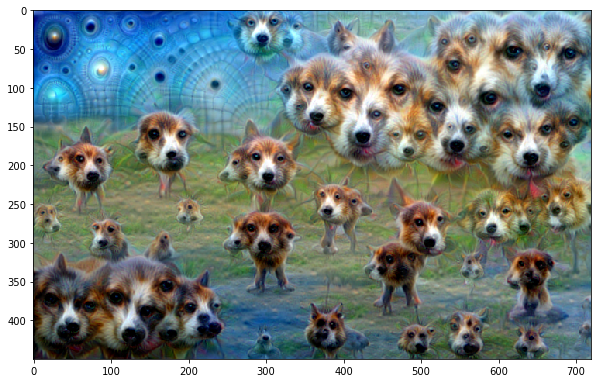

Iteration 19 of mixed4b


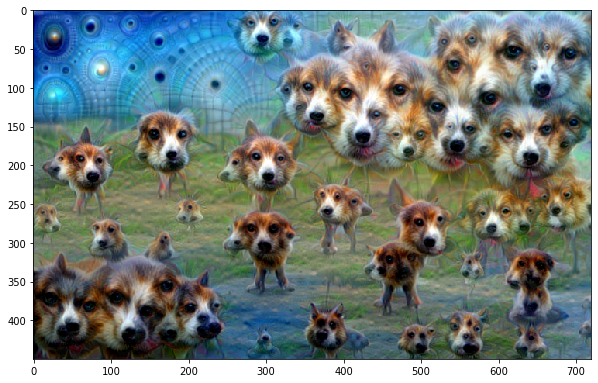

Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.


In [9]:
img = image.copy()
imgs = []

for i in range(20):
    print('Iteration %d of mixed4b' % i)
    
    img = recursive_dream(layers[6], img)
    
    plt.figure(figsize=(10, 15))
    plt.imshow(img / 255.)
    plt.show()
    imgs.append(img)

mimsave('imgs/mixed4b.gif', imgs, fps=5)